In [29]:
import sys
import os
sys.path.append(os.path.abspath('').split('LiverStagePipeline')[-2] + 'LiverStagePipeline')

import numpy as np
import pandas as pd

import torch
import torch.optim as optim
from torch.utils.data import DataLoader

import get_models as get_models
from segmentation.AI.datasets import MicroscopyDataset
from segmentation.evaluate import Inferenceinator
from segmentation.conventional.cell_watershed import segment_cells_in_folder as conv_seg


from utils import setup, data_utils, cell_viewer
from feature_analysis import features, plot_features
from feature_analysis.cell_dataset import CellDataset
from feature_analysis.VAE_models import VAE
from feature_analysis.train import train_VAE
from feature_analysis import inference, dimensionality_reduction, plot_lowdim, evaluate_clusters

torch.set_default_dtype(torch.float64)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu") 
if not torch.cuda.is_available():
    print("Using non-cuda device: {}".format(device))

In [30]:
# Global settings
session_name = 'FoI_1'#'FoI_1''6c'
pipeline_files_folder = '/mnt/DATA1/anton/pipeline_files'

hsp_channel, dapi_channel = 1, 0 # lowres
threads = 20

In [31]:
paths = setup.setup(pipeline_files_folder, session_name=session_name)

# Segmentation

In [32]:
# settings
model_path = '/mnt/DATA1/anton/pipeline_files/segmentation/models/best_model.pth'
segmentation_batch_size = 10

tif_folder = '/mnt/DATA1/anton/data/force_of_infection/tifs'

In [33]:
image_paths = data_utils.get_paths(tif_folder) # list of paths to tif files
channels = [[dapi_channel, hsp_channel] for img_path in image_paths]

In [34]:
# parasite segmentation
segmentation_model, segmentation_model_output_parser = get_models.maskrcnn()
segmentation_model.load_state_dict(torch.load(model_path))
segmentation_model.to(device)

image_dataset = MicroscopyDataset(image_paths=image_paths, channels=channels, groups=None, folder_normalize=True, rescale_img=(1040, 1392))
image_loader = torch.utils.data.DataLoader(image_dataset, batch_size=segmentation_batch_size, num_workers=segmentation_batch_size, shuffle=True, collate_fn=data_utils.collate_fn)

test_evaluator = Inferenceinator(image_loader, segmentation_model_output_parser, processes=segmentation_batch_size, evaluate=False, device=device)
res = test_evaluator(segmentation_model, store_folder=paths['parasite_masks_folder'])

In [35]:
# hepatocyte segmentation
image_paths, parasite_mask_paths = data_utils.get_two_sets(tif_folder, paths['parasite_masks_folder'], common_subset=True, return_paths=True)
assert len(image_paths) == len(channels)
DAPI_channels = [dapi_channel] * len(image_paths)
conv_seg(image_paths=image_paths, segmentation_folder=paths['hepatocyte_masks_folder'], parasite_mask_paths=parasite_mask_paths, threads=threads, channels=DAPI_channels, resize_shape=None, normalize=False, equalize_adapthist=12)

/mnt/DATA1/anton/data/force_of_infection/tifs/NF135/4s1h/2019005_1/2019005_135_4s1h_series_58_TileScan_001


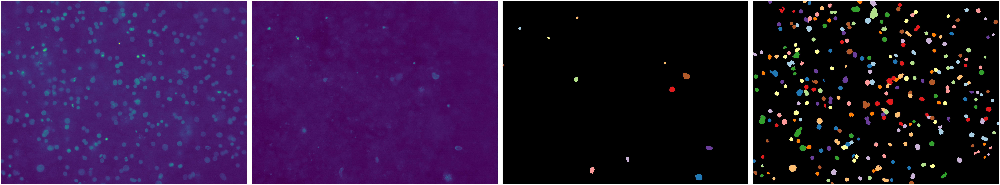

/mnt/DATA1/anton/data/force_of_infection/tifs/NF175/1s4h/2019006c_2/2019006c_NF175_1to4_hsp_dapi_2_series_10_TileScan_001


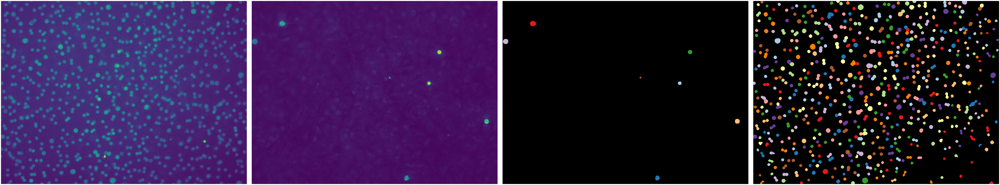

In [36]:
# visualization
cell_viewer.show_folder(tif_dir=tif_folder, seg_dirs=[paths['parasite_masks_folder'], paths['hepatocyte_masks_folder']], eval=False, num_rows=1, num_images=2)

# Feature extraction
Settings:
metadata_func: method that accepts a tif path and outputs relevant metadata (e.g. strain, day, resolution, etc.) in dictionary form. E.g. {'strain': 54, 'day': 7} feature_dict: dictionary indicating which features need to be computed, formatted as {ID: (name, feature_list)}, where ID is either the index of the channel or 'mask' for mask related features such as 'area' or 'solidity'. Name is the prefix for the computed feature in the final csv file. feature_list is a list of features. A feature_dict could be {'mask': ('', ['area', 'solidity']), 1: ('hsp', ['max_intensity', 'min_intensity'])}

In [37]:
# settings
feature_dict = features.default_feature_dict(hsp_channel=hsp_channel, dapi_channel=dapi_channel)

def foi_metadata(tif_path):
    return {'strain': int(tif_path.split('/')[7][2:]), 'foi': tif_path.split('/')[8], 'foi_ratio': int(tif_path.split('/')[8].strip('h').split('s')[0]) / int(tif_path.split('/')[8].strip('h').split('s')[1])}

metadata_func = foi_metadata

print(feature_dict)

{'mask': ('', ['area', 'area_convex', 'area_filled', 'axis_major_length', 'axis_minor_length', 'eccentricity', 'equivalent_diameter_area', 'extent', 'feret_diameter_max', 'perimeter', 'perimeter_crofton', 'solidity', 'avg_(1)_neighbours_distance', 'avg_(3)_neighbours_distance', 'avg_(5)_neighbours_distance', 'avg_(7)_neighbours_distance', 'parasites_within_(100)px', 'parasites_within_(300)px', 'parasites_within_(600)px', 'parasites_within_(900)px', 'parasites_within_(1200)px', 'parasites_within_(2000)px', 'avg_(1)_nearest_hepatocytes_distance', 'avg_(3)_nearest_hepatocytes_distance', 'avg_(5)_nearest_hepatocytes_distance', 'avg_(7)_nearest_hepatocytes_distance', 'avg_(10)_nearest_hepatocytes_distance', 'avg_(15)_nearest_hepatocytes_distance', 'avg_(20)_nearest_hepatocytes_distance', 'avg_(50)_nearest_hepatocytes_distance', 'avg_(100)_nearest_hepatocytes_distance', 'num_hepatocytes_in_(100)px_radius', 'num_hepatocytes_in_(300)px_radius', 'num_hepatocytes_in_(600)px_radius', 'num_hepatoc

In [38]:
# feature extraction
features.collect_features_from_folder(tif_folder=tif_folder, parasite_mask_folder=paths['parasite_masks_folder'], feature_dict=feature_dict, hepatocyte_mask_folder=paths['hepatocyte_masks_folder'], 
                                      csv_path=paths['feature_file'], metadata_func=metadata_func, workers=threads)


# VAE 

In [39]:
# VAE train settings
hidden_dim = 250
latent_dim = 10
learning_rate = 0.001
batch_size = 48
epochs = 150
VAE_mode = 'vanilla'
beta = None
non_feature_columns = ['file', 'label', 'foi', 'foi_ratio', 'strain']#['file', 'label', 'drug']

vae_identifier = '{}_{}LD_{}-VAE_{}epochs'.format(session_name, latent_dim, VAE_mode, epochs)

In [40]:
# Setting some paths
model_path = os.path.join(paths['FA_models_folder'], '{}.pth'.format(vae_identifier))
latent_space_path = os.path.join(paths['FA_latent_spaces_folder'], '{}.csv'.format(vae_identifier))
embeddings_path = os.path.join(paths['FA_embeddings_folder'], '{}.csv'.format(vae_identifier))

#### Creating the dataloaders
df = pd.read_csv(paths['feature_file'])
msk = np.random.rand(len(df)) < 0.8
train_df = df[msk]
test_df = df[~msk]

train_ds = CellDataset(train_df, non_feature_columns=non_feature_columns)
test_ds = CellDataset(test_df, non_feature_columns=non_feature_columns)

train_loader = DataLoader(train_ds, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_ds, batch_size=batch_size, shuffle=True)

### Training the VAE
model = VAE(len(train_ds.features.columns), hidden_dim, latent_dim, mode=VAE_mode, beta=beta) # create VAE model
optimizer = optim.Adam(model.parameters(), lr=learning_rate) # define optimizer

train_VAE(model, train_loader, test_loader, epochs, optimizer, model_path, device)

Epoch 1/150, Train Loss: 2731.007007849636, Test Loss: 2611.709056756779


Epoch 2/150, Train Loss: 2616.1791988621612, Test Loss: 2589.545416505102


Epoch 3/150, Train Loss: 2602.794598031869, Test Loss: 2585.3810510194903


Epoch 4/150, Train Loss: 2596.6184043870794, Test Loss: 2580.119218609668


Epoch 5/150, Train Loss: 2591.695201198795, Test Loss: 2579.5904264020705


Epoch 6/150, Train Loss: 2590.0602447558804, Test Loss: 2578.6411990184038


Epoch 7/150, Train Loss: 2587.0432284001886, Test Loss: 2576.37063320957


Epoch 8/150, Train Loss: 2584.3373004007276, Test Loss: 2568.2038308386764


Epoch 9/150, Train Loss: 2582.7843970388476, Test Loss: 2571.0658489224256


Epoch 10/150, Train Loss: 2582.364894386704, Test Loss: 2566.7988477204844


Epoch 11/150, Train Loss: 2580.3030142929, Test Loss: 2566.842388580171


Epoch 12/150, Train Loss: 2580.676768694657, Test Loss: 2566.448213717568


Epoch 13/150, Train Loss: 2578.381545217898, Test Loss: 2563.0043972551603


Epoch 14/150, Train Loss: 2577.49217987506, Test Loss: 2565.144208629774


Epoch 15/150, Train Loss: 2576.493127983985, Test Loss: 2564.3188011573397


Epoch 16/150, Train Loss: 2579.263397160388, Test Loss: 2564.3590283299095


Epoch 17/150, Train Loss: 2573.850890654262, Test Loss: 2560.258510328603


Epoch 18/150, Train Loss: 2576.316247843833, Test Loss: 2560.8053807513534


Epoch 19/150, Train Loss: 2575.4635477845904, Test Loss: 2561.72241252928


Epoch 20/150, Train Loss: 2575.366405146621, Test Loss: 2561.279217947249


Epoch 21/150, Train Loss: 2574.315200975089, Test Loss: 2564.974855253862


Epoch 22/150, Train Loss: 2572.997359991074, Test Loss: 2561.8910320270707


Epoch 23/150, Train Loss: 2573.0020954500656, Test Loss: 2560.7203915337973


Epoch 24/150, Train Loss: 2573.6000233213504, Test Loss: 2561.0892103966407


Epoch 25/150, Train Loss: 2571.5501952450577, Test Loss: 2561.9110253962835


Epoch 26/150, Train Loss: 2571.830485149831, Test Loss: 2558.7721368611265


Epoch 27/150, Train Loss: 2571.9053584023686, Test Loss: 2563.937907130522


Epoch 28/150, Train Loss: 2570.84448419336, Test Loss: 2556.2099123273283


Epoch 29/150, Train Loss: 2571.5200765376917, Test Loss: 2559.247913775034


Epoch 30/150, Train Loss: 2569.6796687128412, Test Loss: 2556.8219816121336


Epoch 31/150, Train Loss: 2570.7736394171325, Test Loss: 2556.9499993970035


Epoch 32/150, Train Loss: 2570.0298350618305, Test Loss: 2557.079559848448


Epoch 33/150, Train Loss: 2570.7188688998444, Test Loss: 2553.7878278939256


Epoch 34/150, Train Loss: 2569.2073216554554, Test Loss: 2558.909582704069


Epoch 35/150, Train Loss: 2570.147126848722, Test Loss: 2559.4458311396606


Epoch 36/150, Train Loss: 2569.0169209741243, Test Loss: 2555.481230447544


Epoch 37/150, Train Loss: 2568.7888989736957, Test Loss: 2558.0001924118774


Epoch 38/150, Train Loss: 2568.2531375431263, Test Loss: 2552.315980747835


Epoch 39/150, Train Loss: 2569.4992944449173, Test Loss: 2557.484987768229


Epoch 40/150, Train Loss: 2567.3896755841756, Test Loss: 2568.1034154356457


Epoch 41/150, Train Loss: 2569.60646251249, Test Loss: 2557.6543788184904


Epoch 42/150, Train Loss: 2566.575763347259, Test Loss: 2555.3389320245105


Epoch 43/150, Train Loss: 2568.692043261534, Test Loss: 2558.118302277656


Epoch 44/150, Train Loss: 2570.5618236523596, Test Loss: 2551.9420271440463


Epoch 45/150, Train Loss: 2566.938085235174, Test Loss: 2551.118737854472


Epoch 46/150, Train Loss: 2567.9602094941724, Test Loss: 2556.2012119523947


Epoch 47/150, Train Loss: 2567.1283553756352, Test Loss: 2555.404641746784


Epoch 48/150, Train Loss: 2567.7476502873146, Test Loss: 2555.3587960347354


Epoch 49/150, Train Loss: 2566.818690862418, Test Loss: 2554.345648729016


Epoch 50/150, Train Loss: 2566.93208353882, Test Loss: 2553.4521452164227


Epoch 51/150, Train Loss: 2567.018300343924, Test Loss: 2554.434633099867


Epoch 52/150, Train Loss: 2565.9597733741384, Test Loss: 2554.7957953838054


Epoch 53/150, Train Loss: 2566.563360386131, Test Loss: 2554.3321398283733


Epoch 54/150, Train Loss: 2567.5765178776896, Test Loss: 2556.2770597167987


Epoch 55/150, Train Loss: 2566.190514753682, Test Loss: 2553.774878016138


Epoch 56/150, Train Loss: 2565.518875698343, Test Loss: 2550.818537070391


Epoch 57/150, Train Loss: 2567.0207526762865, Test Loss: 2553.3752565078876


Epoch 58/150, Train Loss: 2565.228115286774, Test Loss: 2551.6830839433924


Epoch 59/150, Train Loss: 2566.651122970557, Test Loss: 2554.097580800516


Epoch 60/150, Train Loss: 2565.390813945165, Test Loss: 2554.651952899039


Epoch 61/150, Train Loss: 2565.849379758507, Test Loss: 2560.9125709483105


Epoch 62/150, Train Loss: 2565.7632809198954, Test Loss: 2553.2966634961913


Epoch 63/150, Train Loss: 2565.145015995935, Test Loss: 2553.370390159318


Epoch 64/150, Train Loss: 2566.3308332422494, Test Loss: 2553.0460333835526


Epoch 65/150, Train Loss: 2564.9522231671117, Test Loss: 2553.2729782320907


Epoch 66/150, Train Loss: 2568.3680672660184, Test Loss: 2553.1504466873025


Epoch 67/150, Train Loss: 2572.172819922381, Test Loss: 2551.5959928555694


Epoch 68/150, Train Loss: 2565.9101363665955, Test Loss: 2551.7096077831297


Epoch 69/150, Train Loss: 2565.4982058495166, Test Loss: 2552.3579974795857


Epoch 70/150, Train Loss: 2564.6622800224523, Test Loss: 2553.7300499490384


Epoch 71/150, Train Loss: 2565.3811014641233, Test Loss: 2555.0654712019646


Epoch 72/150, Train Loss: 2565.4328185877507, Test Loss: 2552.7540983867


Epoch 73/150, Train Loss: 2564.855945533695, Test Loss: 2551.165411778161


Epoch 74/150, Train Loss: 2564.8482892932398, Test Loss: 2576.4336826498893


Epoch 75/150, Train Loss: 2566.1745932508884, Test Loss: 2554.564958047854


Epoch 76/150, Train Loss: 2564.1292420027653, Test Loss: 2556.21146104373


Epoch 77/150, Train Loss: 2565.092150945548, Test Loss: 2553.3903078464923


Epoch 78/150, Train Loss: 2564.712687042165, Test Loss: 2552.400955750374


Epoch 79/150, Train Loss: 2564.2365330136463, Test Loss: 2553.6570693793497


Epoch 80/150, Train Loss: 2564.351681440676, Test Loss: 2550.6698341075717


Epoch 81/150, Train Loss: 2564.540930546511, Test Loss: 2551.988910834872


Epoch 82/150, Train Loss: 2564.556180018271, Test Loss: 2554.072973177627


Epoch 83/150, Train Loss: 2564.604008695585, Test Loss: 2551.5846352765766


Epoch 84/150, Train Loss: 2564.410230433251, Test Loss: 2553.145196267257


Epoch 85/150, Train Loss: 2564.974496499251, Test Loss: 2553.219164680182


Epoch 86/150, Train Loss: 2564.7212178279506, Test Loss: 2551.4578327320064


Epoch 87/150, Train Loss: 2564.3277540729396, Test Loss: 2551.281529630932


Epoch 88/150, Train Loss: 2564.371777454497, Test Loss: 2554.2186477915375


Epoch 89/150, Train Loss: 2564.4540201432424, Test Loss: 2552.2484992422596


Epoch 90/150, Train Loss: 2565.100862480064, Test Loss: 2552.955947597745


Epoch 91/150, Train Loss: 2564.755476665538, Test Loss: 2550.131434325251


Epoch 92/150, Train Loss: 2563.1896108973674, Test Loss: 2547.754380072549


Epoch 93/150, Train Loss: 2563.545374738115, Test Loss: 2555.7700211874


Epoch 94/150, Train Loss: 2563.6043514792987, Test Loss: 2551.6866054097727


Epoch 95/150, Train Loss: 2563.838051660162, Test Loss: 2555.1735809592064


Epoch 96/150, Train Loss: 2564.206492283711, Test Loss: 2550.74477885456


Epoch 97/150, Train Loss: 2564.3416640993532, Test Loss: 2549.103657629064


Epoch 98/150, Train Loss: 2562.746103997217, Test Loss: 2551.9268052287666


Epoch 99/150, Train Loss: 2563.5995923844994, Test Loss: 2551.7014109511647


Epoch 100/150, Train Loss: 2563.355432884712, Test Loss: 2550.120697694299


Epoch 101/150, Train Loss: 2563.064505038684, Test Loss: 2549.615428988775


Epoch 102/150, Train Loss: 2564.532629758222, Test Loss: 2550.4180439535094


Epoch 103/150, Train Loss: 2563.2860220215193, Test Loss: 2550.453438435069


Epoch 104/150, Train Loss: 2563.801048467527, Test Loss: 2553.440165791289


Epoch 105/150, Train Loss: 2564.0776910135505, Test Loss: 2549.495055089921


Epoch 106/150, Train Loss: 2563.503211769159, Test Loss: 2552.8262044016283


Epoch 107/150, Train Loss: 2563.071130438088, Test Loss: 2551.2088603933316


Epoch 108/150, Train Loss: 2565.231903713464, Test Loss: 2553.586124079351


Epoch 109/150, Train Loss: 2563.5945205114117, Test Loss: 2553.3823022287716


Epoch 110/150, Train Loss: 2563.393499177174, Test Loss: 2548.3943356763516


Epoch 111/150, Train Loss: 2562.838303226268, Test Loss: 2548.9188249748904


Epoch 112/150, Train Loss: 2563.186191120135, Test Loss: 2553.8073252910117


Epoch 113/150, Train Loss: 2563.627297195088, Test Loss: 2549.751582942697


Epoch 114/150, Train Loss: 2563.5602901347024, Test Loss: 2552.2837741930553


Epoch 115/150, Train Loss: 2563.748299546718, Test Loss: 2550.0814281821636


Epoch 116/150, Train Loss: 2563.4277512598615, Test Loss: 2551.802588454761


Epoch 117/150, Train Loss: 2563.5062032303954, Test Loss: 2553.436258465206


Epoch 118/150, Train Loss: 2563.084571251899, Test Loss: 2549.1203730377506


Epoch 119/150, Train Loss: 2563.1048904988284, Test Loss: 2549.683784709995


Epoch 120/150, Train Loss: 2563.1987269551687, Test Loss: 2550.2406504512805


Epoch 121/150, Train Loss: 2562.9768439923528, Test Loss: 2550.6702623099877


Epoch 122/150, Train Loss: 2562.7875501795593, Test Loss: 2551.744065478241


Epoch 123/150, Train Loss: 2562.7899570492514, Test Loss: 2550.9074500868855


Epoch 124/150, Train Loss: 2562.876422437355, Test Loss: 2550.5688742568263


Epoch 125/150, Train Loss: 2563.0359674227875, Test Loss: 2553.5315679859887


Epoch 126/150, Train Loss: 2562.7199003084506, Test Loss: 2548.734554599371


Epoch 127/150, Train Loss: 2563.058110034956, Test Loss: 2551.9943833902535


Epoch 128/150, Train Loss: 2563.99539059718, Test Loss: 2550.718213134016


Epoch 129/150, Train Loss: 2563.1089751697104, Test Loss: 2552.126966421791


Epoch 130/150, Train Loss: 2562.6056957273554, Test Loss: 2551.749663383529


Epoch 131/150, Train Loss: 2562.730982454913, Test Loss: 2550.9423448616403


Epoch 132/150, Train Loss: 2562.542695150885, Test Loss: 2548.0547692372206


Epoch 133/150, Train Loss: 2563.860448786367, Test Loss: 2551.72590071167


Epoch 134/150, Train Loss: 2562.4790051943264, Test Loss: 2551.566532679295


Epoch 135/150, Train Loss: 2562.9435021828785, Test Loss: 2552.344389684611


Epoch 136/150, Train Loss: 2562.2059455816975, Test Loss: 2551.790423734301


Epoch 137/150, Train Loss: 2564.4668366352134, Test Loss: 2555.599357233024


Epoch 138/150, Train Loss: 2561.640232019939, Test Loss: 2551.5641167290337


Epoch 139/150, Train Loss: 2563.7805395041646, Test Loss: 2550.697511824292


Epoch 140/150, Train Loss: 2562.565448332441, Test Loss: 2551.095908157615


Epoch 141/150, Train Loss: 2563.0733711459043, Test Loss: 2552.101765912576


Epoch 142/150, Train Loss: 2563.789198420482, Test Loss: 2551.6599689569566


Epoch 143/150, Train Loss: 2562.9667177965825, Test Loss: 2550.5124058318847


Epoch 144/150, Train Loss: 2563.5430263128, Test Loss: 2549.0114565332774


Epoch 145/150, Train Loss: 2563.12510585628, Test Loss: 2550.100839261493


Epoch 146/150, Train Loss: 2562.741575427866, Test Loss: 2550.659476537572


Epoch 147/150, Train Loss: 2563.13683715887, Test Loss: 2550.4258401292086


Epoch 148/150, Train Loss: 2564.2624380687535, Test Loss: 2550.3929966304427


Epoch 149/150, Train Loss: 2562.318377167424, Test Loss: 2548.595166898122


Epoch 150/150, Train Loss: 2561.5970096499836, Test Loss: 2550.3971638390085


In [45]:
## inference
model.load_state_dict(torch.load(model_path)) # load best performing version of model

complete_ds = CellDataset(df, non_feature_columns=non_feature_columns)
complete_loader = DataLoader(complete_ds, batch_size=batch_size, shuffle=False)

latent_space_df = inference.get_latent_embedding(model, complete_loader, device, latent_space_path=latent_space_path)

# Comparing groups

In [53]:
# Dimension reduction settings
dimensionality_reducer = 'umap'

comparison_groups = ['strain', 'foi']#['drug']
marker_size = 12
alpha = 0.3

label_settings = {'foi': 
                        [['8s1h', '$\dfrac{8}{1}$'], 
                        ['4s1h', '$\dfrac{4}{1}$'],
                        ['2s1h', '$\dfrac{2}{1}$'],
                        ['1s1h', '$\dfrac{1}{1}$'],
                        ['1s2h', '$\dfrac{1}{2}$'],
                        ['1s4h', '$\dfrac{1}{4}$'],
                        ['1s8h', '$\dfrac{1}{8}$'],
                        ['1s16h', '$\dfrac{1}{16}$'],
                        ['1s32h', '$\dfrac{1}{32}$']],
                   'strain': 
                   [
                    ['54.0', 'NF54'],
                    ['135.0', 'NF135'],
                    ['175.0', 'NF175']
                   ]
                    }
gradual = {'foi': True, 'strain': False}

colormaps = {'foi': 'viridis', 'strain': 'Dark2'}

In [47]:
# Dimensionality reduction
dimensionality_reduction.reduce(dimensionality_reducer, latent_space_df, save_path=embeddings_path)

,Dimension 0,Dimension 1
0,10.067491,3.069556
1,9.173935,1.660026
2,5.572835,0.051878
3,6.551459,6.499183
4,10.087603,5.095354
...,...,...
112701,7.193282,-1.070688
112702,8.037572,1.530216
112703,7.398178,4.024768
112704,10.117519,4.003955


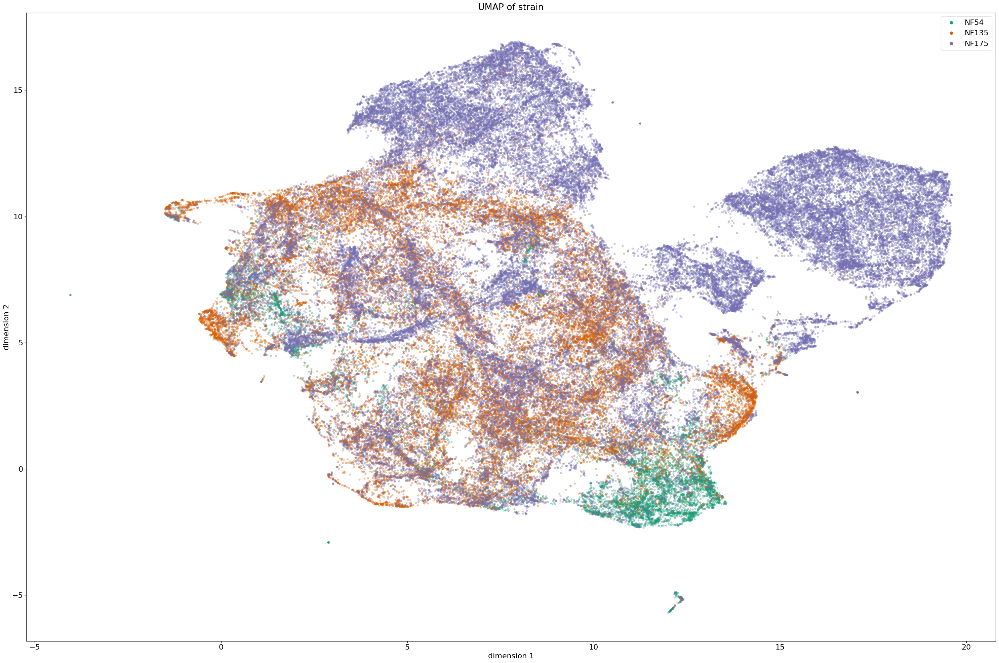

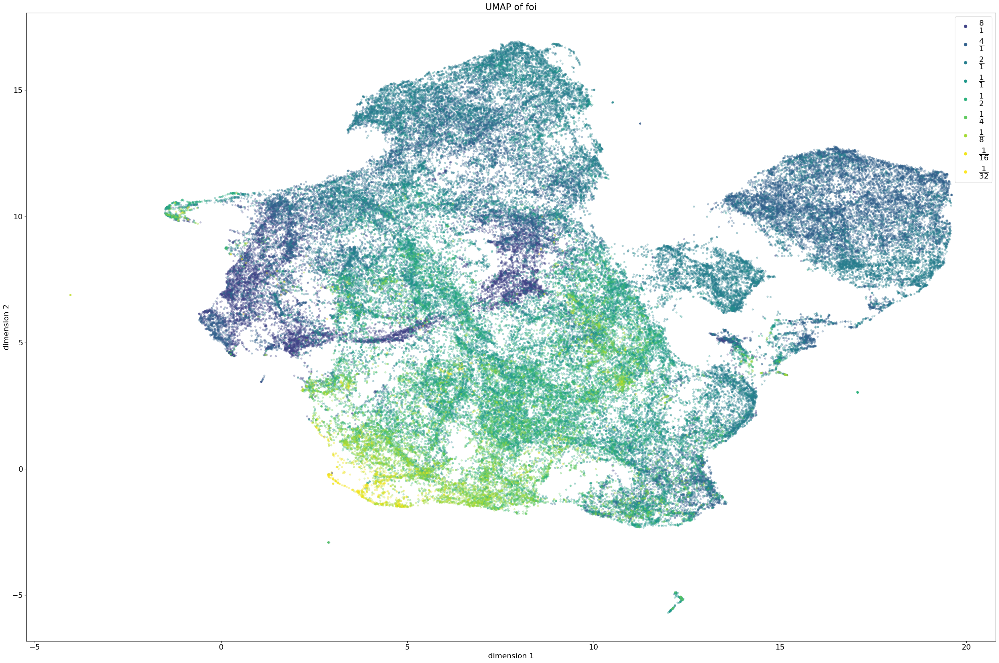

In [55]:
# Dimensionality reduction plotting
for feature in comparison_groups:
    figure_path = os.path.join(paths['FA_latent_space_plots_folder'], '{}_{}-of-{}.png'.format(vae_identifier, dimensionality_reducer.upper(), feature))
    title = '{} of {}'.format(dimensionality_reducer.upper(), feature)
    labels = df[feature]

    plot_lowdim.plot(embeddings_path, labels, title=title, save_path=figure_path, show=True, marker_size=marker_size, alpha=alpha, colormap=colormaps[feature], label_settings=label_settings[feature], gradual=gradual[feature])

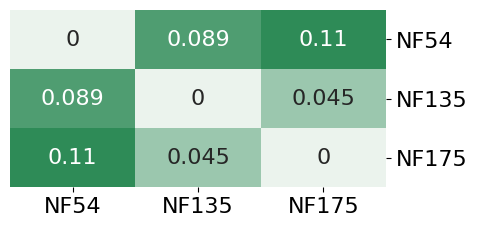

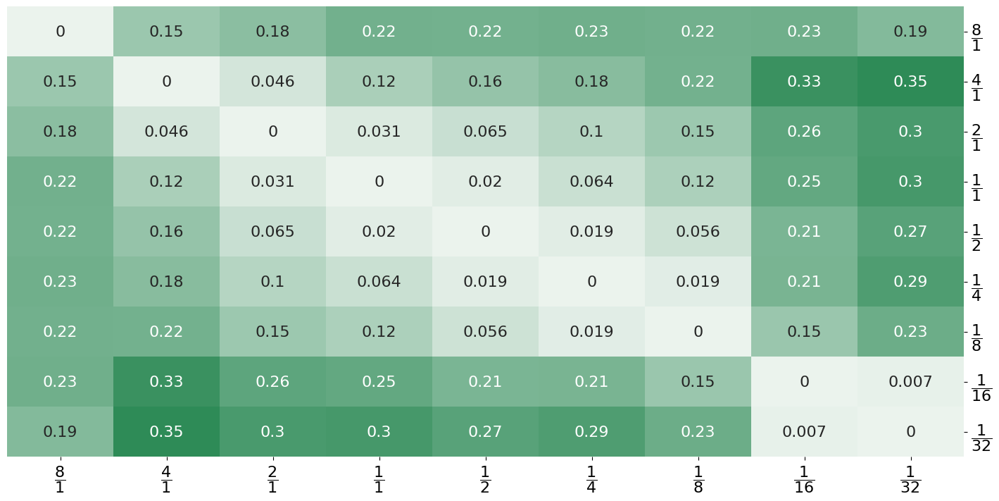

In [49]:
# Generating distance matrices
latent_space_df = pd.read_csv(latent_space_path)
for feature in comparison_groups:
    figure_path = os.path.join(paths['FA_latent_space_matrices_folder'], '{}_silhouette_scores_of_{}.png'.format(vae_identifier, feature))
    labels = [str(l) for l in df[feature]]
    mean, scores = evaluate_clusters.get_sillhouette_scores(latent_space_df, labels)
    ls = label_settings[feature] if label_settings and feature in label_settings.keys() else None
    evaluate_clusters.plot_distance_matrix(scores, show=True, save_path=figure_path, label_settings=ls)

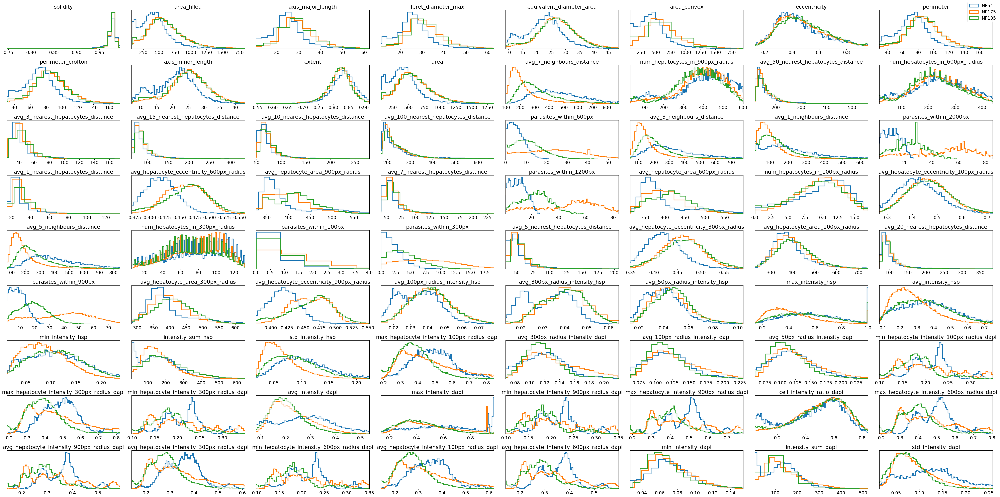

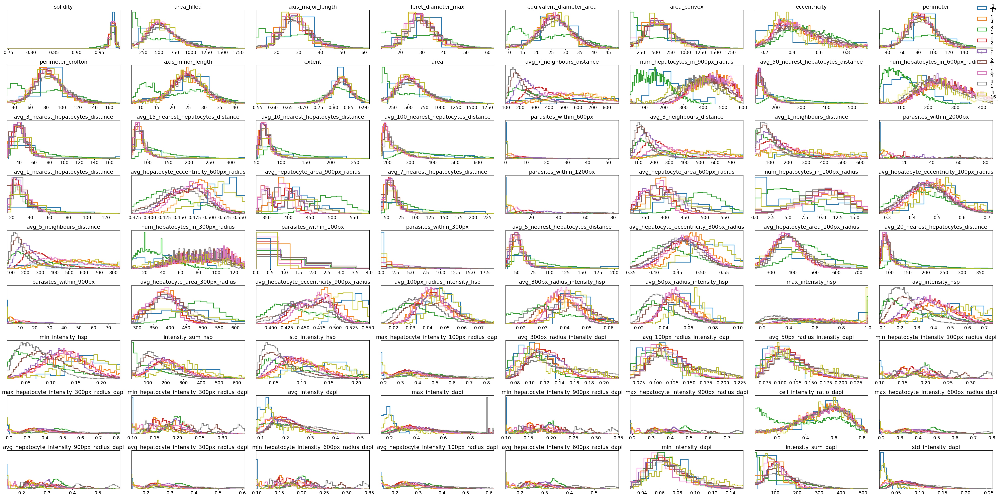

In [50]:

features_df = df.drop(columns=non_feature_columns)

for grouping in comparison_groups:
    labels = df[grouping]
    if label_settings and grouping in label_settings.keys():
        label_settings_dict = {l[0]: l[1] for l in label_settings[grouping]}
        labels = [label_settings_dict[str(l)] for l in labels]
        
    plot_features.multiplot(features=features_df, labels=labels, nrows=9, nbins=120)